In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from anndata import AnnData
import scanpy as sc

/opt/conda/lib/python3.9/site-packages/pandas/core/computation/expressions.py:21: UserWarning: Pandas requires version '2.8.0' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


In [2]:
data = sc.read("data/V1_Mouse_Brain_Sagittal_Anterior.h5ad")

/opt/conda/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/opt/conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [3]:
est_props = pd.read_table("data/DISSECT.txt", index_col=0)
est_scores = pd.read_table("data/DISSECT_scores.txt", index_col=0)

est_scores[est_scores<0] = 0
est_scores = est_scores.div(est_scores.sum(1), 0)
data_props = data.copy()
data_scores = data.copy()

data_props.obs = pd.concat([data_props.obs, est_props], axis=1)
data_scores.obs = pd.concat([data_scores.obs, est_scores], axis=1)

/opt/conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [4]:
sc.set_figure_params(dpi=250)
exc_cts = [col for col in data_props.obs.columns if "L" in col and col not in ["Lamp5", "VLMC"]]

In [5]:
sns.set(style="white", font_scale=0.7)

In [6]:
cmap = "magma"

In [7]:
data_scores_tmp = AnnData(est_scores)

In [8]:
sc.tl.pca(data_scores_tmp)
sc.pp.neighbors(data_scores_tmp)
sc.tl.louvain(data_scores_tmp, resolution=1)
sc.tl.umap(data_scores_tmp)

In [9]:
data_scores_tmp.obs["Nrgn"] = np.array(data_scores[:, "Nrgn"].X)

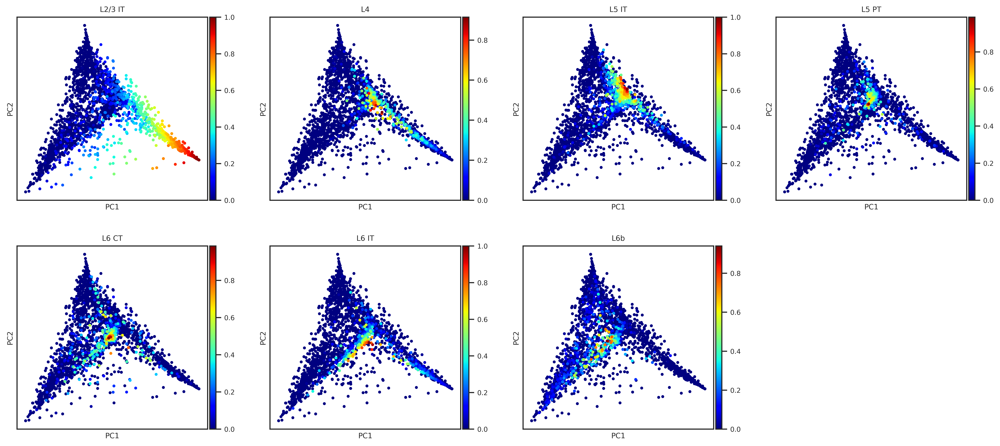

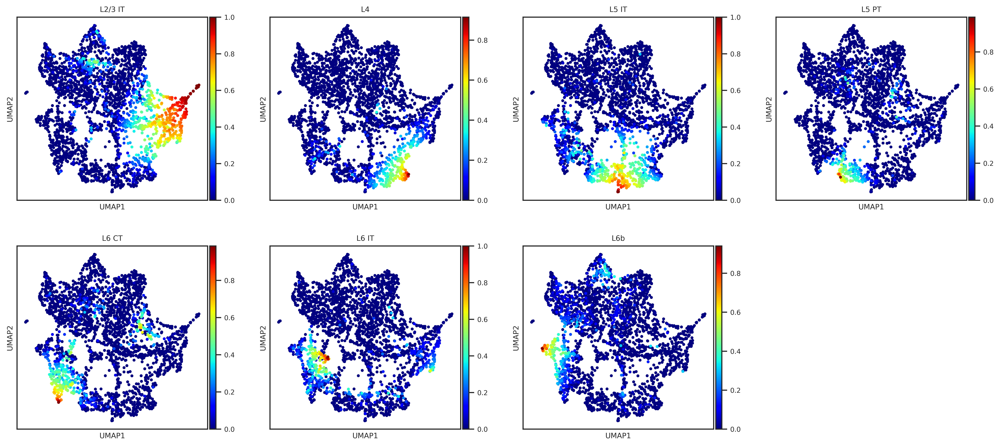

In [10]:
sc.pl.pca(data_scores_tmp, color=[col for col in exc_cts if "Lamp5" not in col], cmap="jet")
sc.pl.umap(data_scores_tmp, color=[col for col in exc_cts if "Lamp5" not in col], cmap="jet")

In [11]:
labels = est_scores.idxmax(1)
data_scores_tmp.obs["celltype"] = labels

/opt/conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


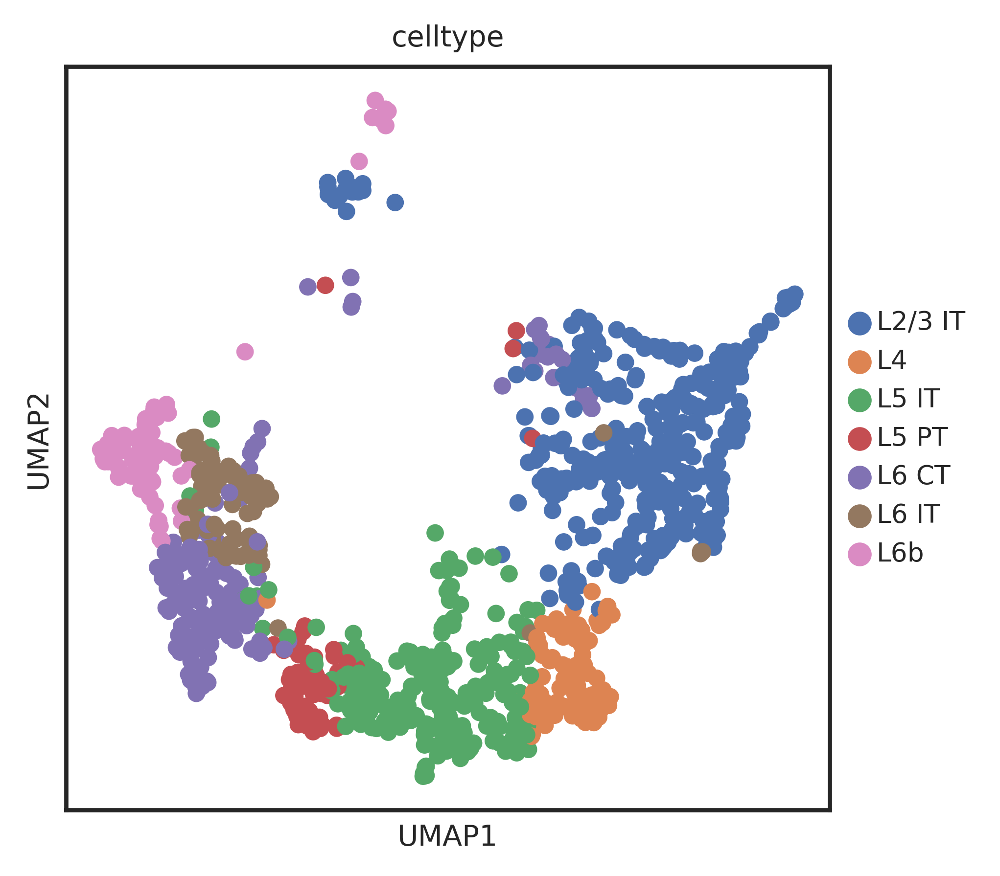

In [12]:
sc.pl.umap(data_scores_tmp[data_scores_tmp.obs.celltype.isin([col for col in exc_cts if "Lamp5" not in col])], 
           color=["celltype"], cmap="jet", vmax="p99")

In [19]:
palette = sns.color_palette("Set1_r", tmp.obs.label.unique().shape[0]+1)

In [20]:
colors = palette.as_hex()

In [21]:
tmp.uns["label_colors"] = colors[1:]

In [25]:
from sklearn import metrics
metrics.silhouette_score(data_scores_tmp.X, labels, metric='euclidean')


0.29014224

In [28]:
from sklearn import metrics
metrics.silhouette_score(data_scores_tmp.X, labels, metric='correlation')

0.5056128880228626

In [26]:
import scipy
dist_mat = scipy.spatial.distance.pdist(data_scores_tmp.X, metric="jensenshannon")
dist_mat = scipy.spatial.distance.squareform(dist_mat, force='no', checks=True)

In [27]:
metrics.silhouette_score(dist_mat, labels, metric="precomputed")

0.15906330468599467

In [47]:
metrics.silhouette_score(data_scores_tmp.X, labels, metric='cosine')

0.500932

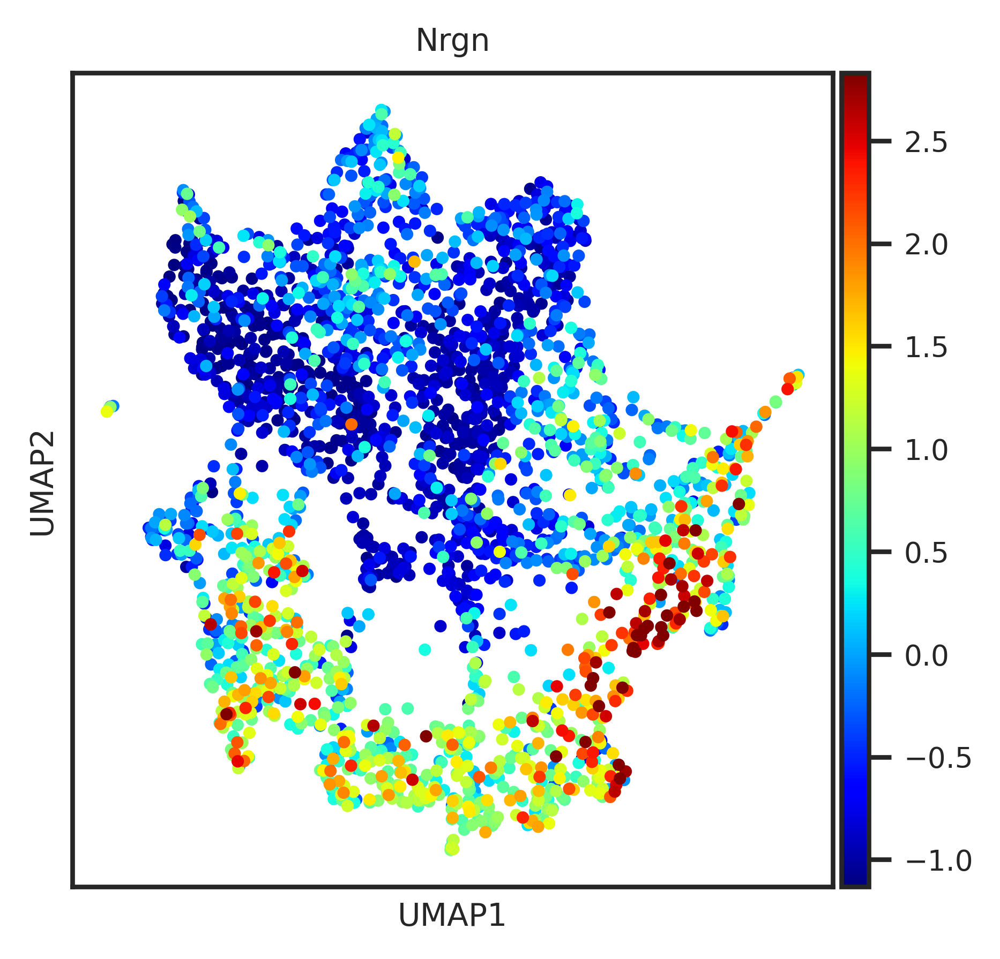

In [39]:
sc.pl.umap(data_scores_tmp, color=["Nrgn"], cmap="jet", vmax="p99")

In [31]:
data_scores_tmp.obs["Gfap"] = np.array(data_scores[:, "Gfap"].X)

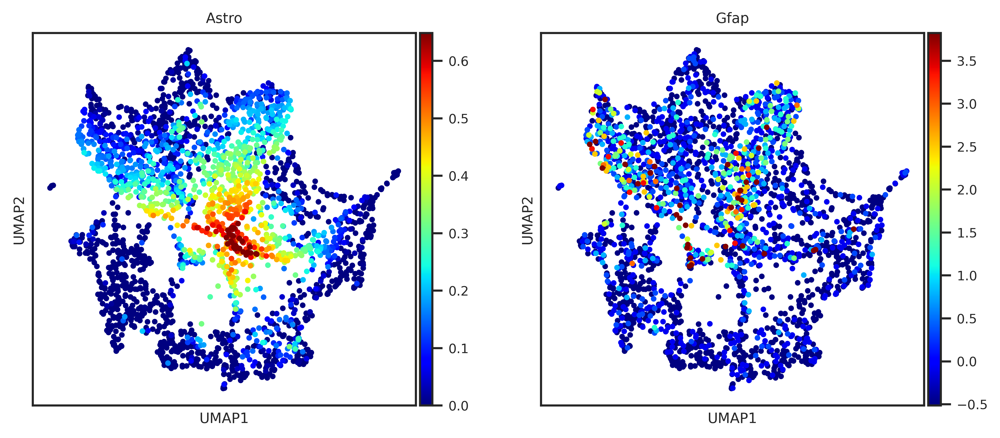

In [33]:
sc.pl.umap(data_scores_tmp, color=["Astro", "Gfap"], cmap="jet", vmax="p99")

In [10]:
sc.pp.scale(data_scores)

In [11]:
data_scores.obs["louvain"] = data_scores_tmp.obs["louvain"]

Text(0, 0.5, 'Louvain clusters (resolution=1)')

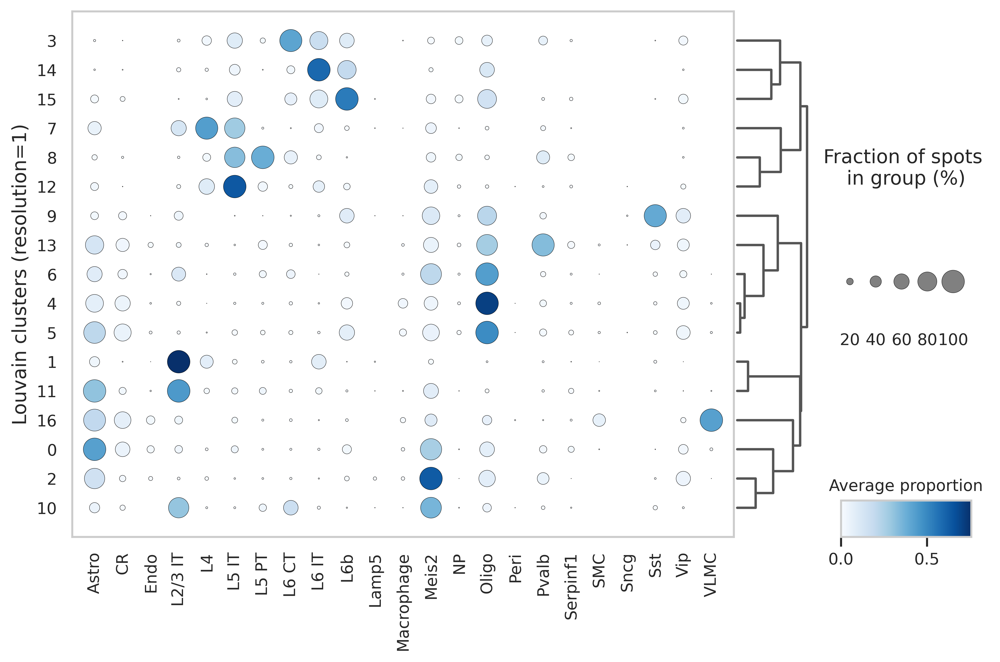

In [12]:
sns.set(style="whitegrid", font_scale=1)
g=sc.pl.dotplot(data_scores_tmp, var_names=data_scores_tmp.var_names, groupby="louvain",
             figsize=(10,6), swap_axes=False, cmap="Blues", colorbar_title="Average proportion",
             show=False, dendrogram=True, )
g["size_legend_ax"].set_title("Fraction of spots \nin group (%)")
g["mainplot_ax"].set_ylabel("Louvain clusters (resolution=1)")
plt.savefig("plots/clusters_brain.png", bbox_inches="tight")

In [11]:
tmp = data_scores[data_scores.obs.louvain.isin(["1", "7",  "3", "8", "12", "14", "15"])]
mapping = {"1": "L2/3",
                                "7": "L4",
                                "8": "L5 PT",
                                "12": "L5 IT",
                                  "3": "L6 CT",
                                "14": "L6 IT",
                                 "15": "L6b"}
order = list(mapping.values())
tmp.obs.louvain.replace(mapping, inplace=True)

In [12]:
tmp.obs["louvain"] = tmp.obs["louvain"].cat.reorder_categories(order)

/tmp/ipykernel_87715/1273850751.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  tmp.obs["louvain"] = tmp.obs["louvain"].cat.reorder_categories(order)
/opt/conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [14]:
palette = sns.color_palette("Set1_r", tmp.obs.louvain.unique().shape[0]+1)

In [15]:
colors = palette.as_hex()

In [16]:
tmp.uns["louvain_colors"] = colors[1:]

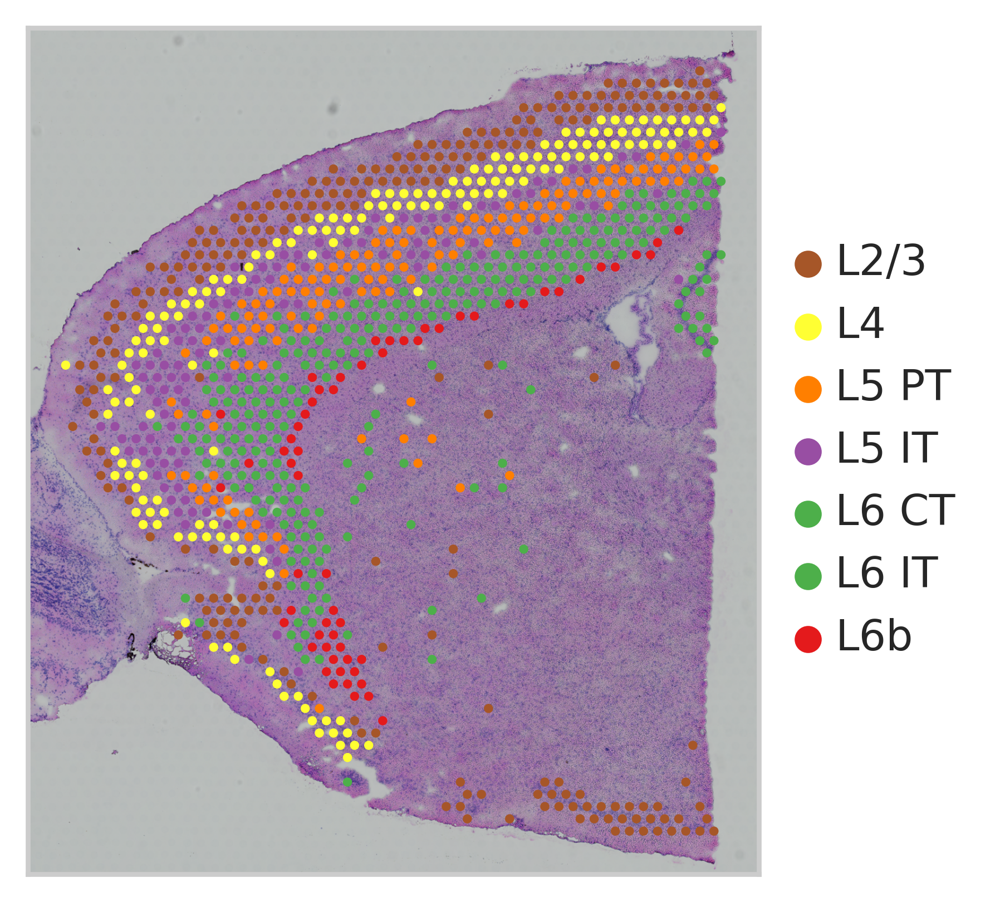

In [17]:
g = sc.pl.spatial(tmp, color=["louvain"], show=False)
g[0].set_ylabel("")
g[0].set_xlabel("")
g[0].set_title("")
plt.savefig("plots/show_louvain_clusters.png", bbox_inches="tight")

In [9]:
data_scores_tmp.obs["Nrgn"] = np.array(data_scores[:, "Nrgn"].X)

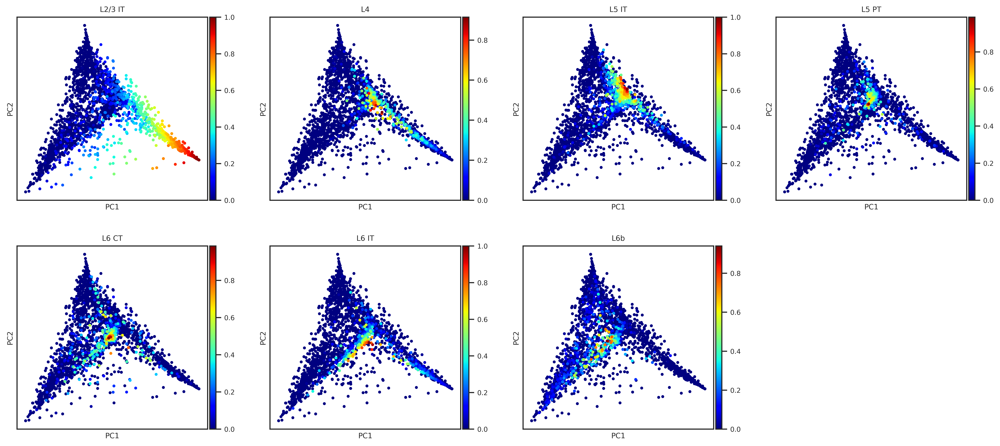

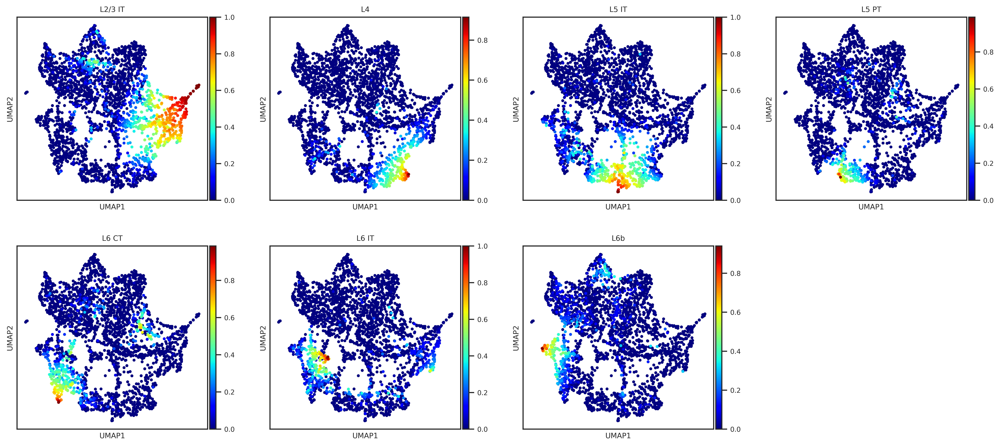

In [10]:
sc.pl.pca(data_scores_tmp, color=[col for col in exc_cts if "Lamp5" not in col], cmap="jet")
sc.pl.umap(data_scores_tmp, color=[col for col in exc_cts if "Lamp5" not in col], cmap="jet")

In [11]:
labels = est_scores.idxmax(1)
data_scores_tmp.obs["celltype"] = labels

/opt/conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


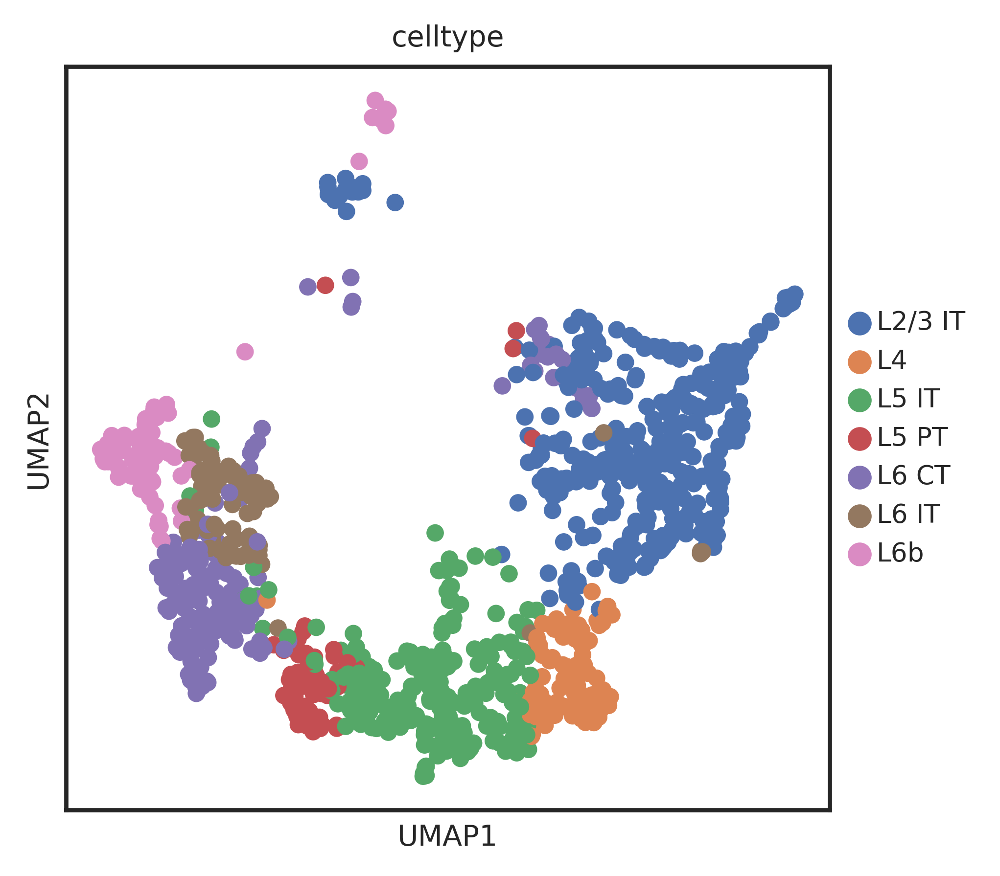

In [12]:
sc.pl.umap(data_scores_tmp[data_scores_tmp.obs.celltype.isin([col for col in exc_cts if "Lamp5" not in col])], 
           color=["celltype"], cmap="jet", vmax="p99")

In [19]:
palette = sns.color_palette("Set1_r", tmp.obs.label.unique().shape[0]+1)

In [20]:
colors = palette.as_hex()

In [21]:
tmp.uns["label_colors"] = colors[1:]

In [25]:
from sklearn import metrics
metrics.silhouette_score(data_scores_tmp.X, labels, metric='euclidean')


0.29014224

In [28]:
from sklearn import metrics
metrics.silhouette_score(data_scores_tmp.X, labels, metric='correlation')

0.5056128880228626

In [26]:
import scipy
dist_mat = scipy.spatial.distance.pdist(data_scores_tmp.X, metric="jensenshannon")
dist_mat = scipy.spatial.distance.squareform(dist_mat, force='no', checks=True)

In [27]:
metrics.silhouette_score(dist_mat, labels, metric="precomputed")

0.15906330468599467

In [47]:
metrics.silhouette_score(data_scores_tmp.X, labels, metric='cosine')

0.500932

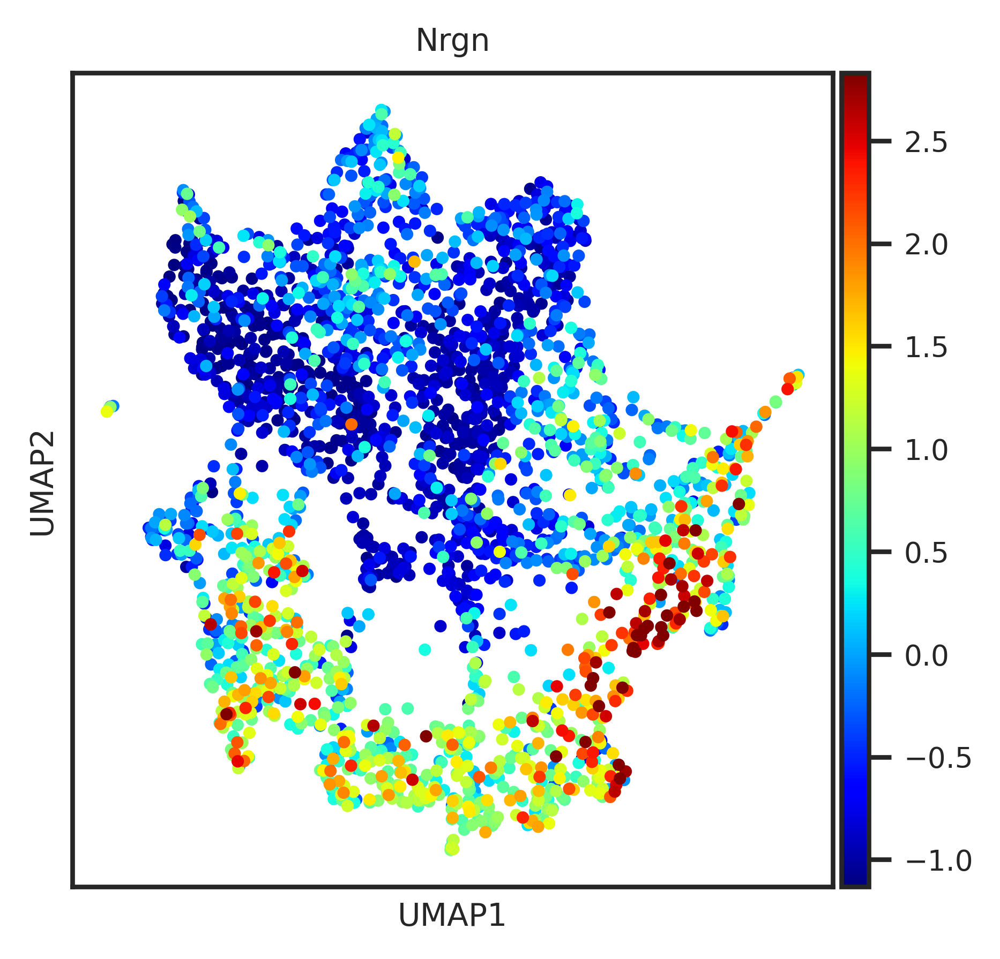

In [39]:
sc.pl.umap(data_scores_tmp, color=["Nrgn"], cmap="jet", vmax="p99")

In [31]:
data_scores_tmp.obs["Gfap"] = np.array(data_scores[:, "Gfap"].X)

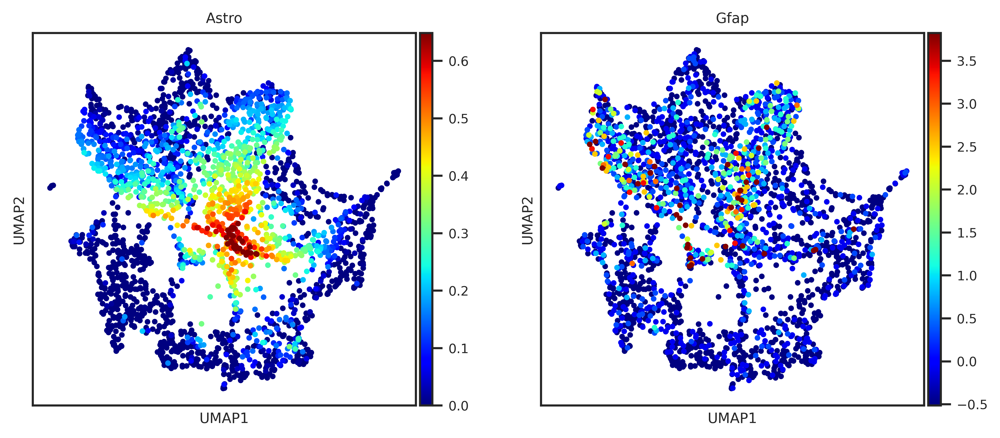

In [33]:
sc.pl.umap(data_scores_tmp, color=["Astro", "Gfap"], cmap="jet", vmax="p99")

In [10]:
sc.pp.scale(data_scores)

In [11]:
data_scores.obs["louvain"] = data_scores_tmp.obs["louvain"]

Text(0, 0.5, 'Louvain clusters (resolution=1)')

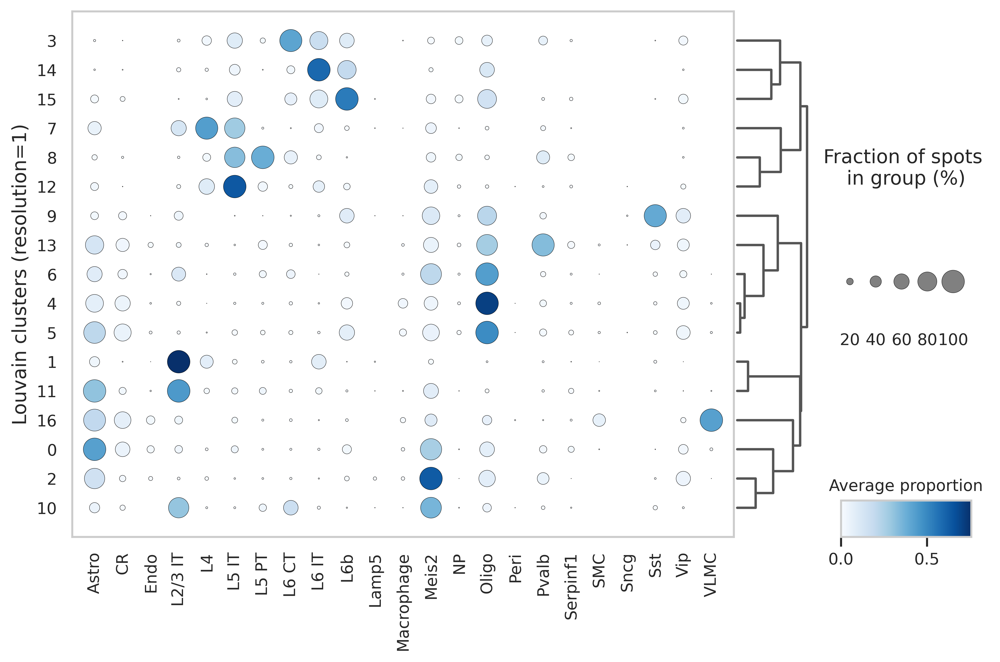

In [12]:
sns.set(style="whitegrid", font_scale=1)
g=sc.pl.dotplot(data_scores_tmp, var_names=data_scores_tmp.var_names, groupby="louvain",
             figsize=(10,6), swap_axes=False, cmap="Blues", colorbar_title="Average proportion",
             show=False, dendrogram=True, )
g["size_legend_ax"].set_title("Fraction of spots \nin group (%)")
g["mainplot_ax"].set_ylabel("Louvain clusters (resolution=1)")
plt.savefig("plots/clusters_brain.png", bbox_inches="tight")

In [11]:
tmp = data_scores[data_scores.obs.louvain.isin(["1", "7",  "3", "8", "12", "14", "15"])]
mapping = {"1": "L2/3",
                                "7": "L4",
                                "8": "L5 PT",
                                "12": "L5 IT",
                                  "3": "L6 CT",
                                "14": "L6 IT",
                                 "15": "L6b"}
order = list(mapping.values())
tmp.obs.louvain.replace(mapping, inplace=True)

In [12]:
tmp.obs["louvain"] = tmp.obs["louvain"].cat.reorder_categories(order)

/tmp/ipykernel_87715/1273850751.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  tmp.obs["louvain"] = tmp.obs["louvain"].cat.reorder_categories(order)
/opt/conda/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [14]:
palette = sns.color_palette("Set1_r", tmp.obs.louvain.unique().shape[0]+1)

In [15]:
colors = palette.as_hex()

In [16]:
tmp.uns["louvain_colors"] = colors[1:]

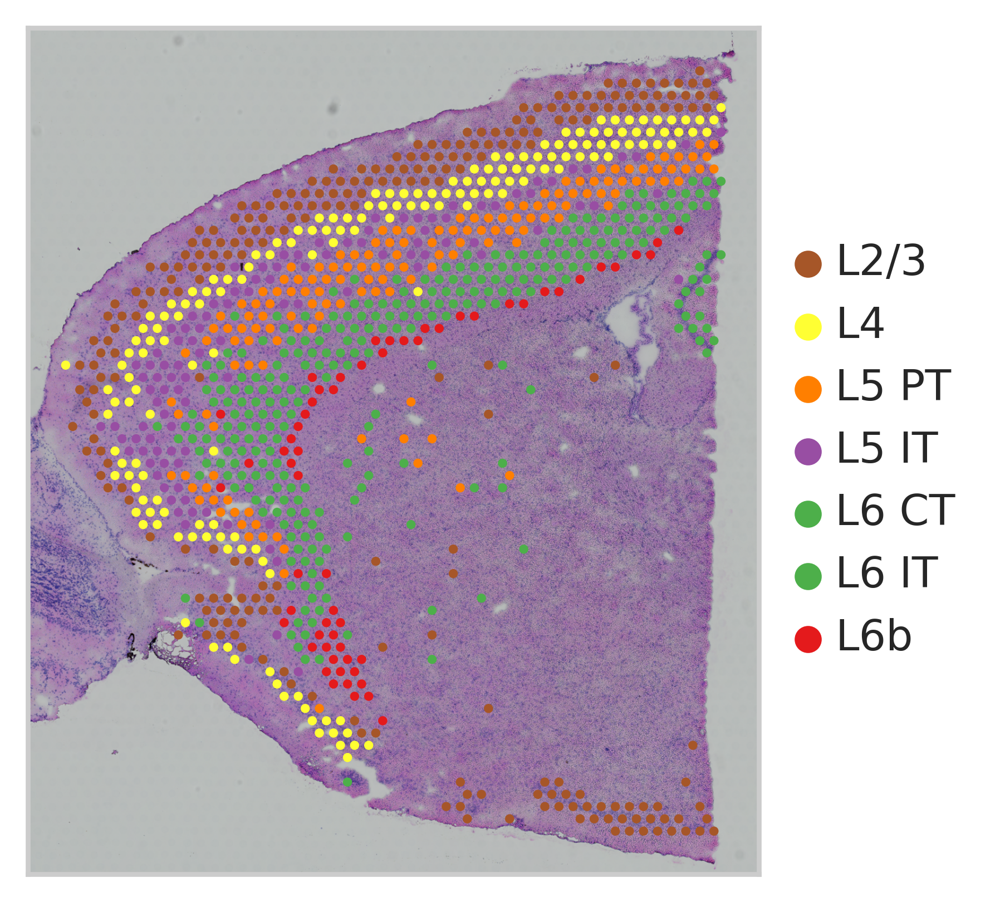

In [17]:
g = sc.pl.spatial(tmp, color=["louvain"], show=False)
g[0].set_ylabel("")
g[0].set_xlabel("")
g[0].set_title("")
plt.savefig("plots/show_louvain_clusters.png", bbox_inches="tight")

In [2]:
sns.set(style="whitegrid", font_scale=1.3)

In [3]:
df_shl = pd.read_csv("data/shl.csv", index_col=0)

In [4]:
pal = sns.color_palette("colorblind", 7).as_hex()

In [5]:
pal

['#0173b2', '#de8f05', '#029e73', '#d55e00', '#cc78bc', '#ca9161', '#fbafe4']

In [6]:
palette = {"DISSECT": pal[-1],
        "C2L": pal[0],
        "RCTD": pal[2],
          "SONAR": pal[3],
          "CARD": pal[4]}

In [7]:
import warnings
warnings.filterwarnings("ignore")

In [8]:
sns.set(style="whitegrid")

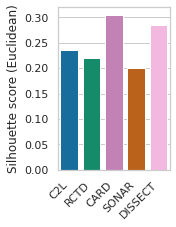

In [9]:
plt.figure(figsize=(2,3))
sns.barplot(data=df_shl, x="index", y="Silhouette", order=["C2L", "RCTD", "CARD", "SONAR", "DISSECT", ], palette=palette)
plt.yticks(np.arange(0, 0.35, 0.05))
plt.xlabel("")
plt.xticks(rotation=45, ha="right")
plt.ylabel("Silhouette score (Euclidean)")
plt.savefig("plots/silhouette.pdf", bbox_inches="tight")
plt.savefig("plots/silhouette.png", bbox_inches="tight", dpi=300)